In [52]:
%load_ext autoreload
%autoreload 2
%reload_ext autoreload
import sqlite3
import pandas as pd
import numpy as np
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
import torch
from tqdm import tqdm
import unicodedata
import torch.nn as nn
import torch.optim as optim
from bert_encoder import document_retrieval, DualEncoderBert, DualEncoderRoberta, DataLoaderNegativeBatches, DataLoaderNegativeBatchesEmbeddings, DataLoaderNegativeBatchesEmbeddingsMixed, TextDataGenerator, validate, train, bert_encode_docs, bert_encode_claims
from torch.utils.data import DataLoader
import pickle
import faiss
import os
import math
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
import seaborn as sns
import matplotlib.pyplot as plt
from preprocessing import expand_rows, expand_retrieval_ids, map_retrieval_ids
from tqdm import tqdm
import matplotlib.ticker as mtick
import matplotlib.pyplot as plt
import matplotlib
import numpy as np
import seaborn as sns
from matplotlib.colors import LinearSegmentedColormap
import plotly.graph_objects as go
from umap import UMAP
from sentence_transformers import SentenceTransformer
from bertopic import BERTopic
from hdbscan import HDBSCAN

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [53]:
from nlp_results import *

# Perform Maximum inner product search

In [3]:
model = 'bs128'
top_k = 100

In [4]:
# load embeddings
embeddings_claims, embeddings_wiki = read_data(model)

In [7]:
# Perform maximum inner product search
mips_top_indices, mips_top_scores = mips(embeddings_claims, embeddings_wiki, model, top_k, save=True)

100%|██████████| 32/32 [05:20<00:00, 10.00s/it]


In [4]:
# or load results from mips
mips_top_indices, mips_top_scores = load_mips_results(model, top_k)

In [ ]:
# load_DB and create dictionary which maps article names to their corresponding indexes
df_DB, article_name_index_map = load_wiki_DB(create_mapping=True) 

In [67]:
# load hover test dataset
df_hover = prepare_hover_dataset(pd.read_json('hover-main/data/hover/hover_dev_release_v1.1.json'))
df_hover = add_retrieval_ids(df_hover, mips_top_indices)

100%|██████████| 4000/4000 [00:00<00:00, 14147.11it/s]


# Calculate Metrics

## For BERT Models

In [103]:
for model in ['bs16_tfidf', 'bs32', 'bs64', 'bs128', 'bs200']:
    # load results from mips
    mips_top_indices, mips_top_scores = load_mips_results(model, top_k)
    # load hover test dataset
    df_hover = prepare_hover_dataset(pd.read_json('hover-main/data/hover/hover_dev_release_v1.1.json'))
    df_hover = add_retrieval_ids(df_hover, mips_top_indices)

    for label in ['all', 'NOT_SUPPORTED', 'SUPPORTED']:

        # calculate metrics
        if label != 'all':
            df = df_hover[df_hover['label']==label].copy()
        else:
            df = df_hover

        top_k_list = [5,10,20,30,40,50,60,70,80,90,100]
        num_hops_list = [2,3,4,'all']
        df_hits, df_recall = calculate_metrics(df, top_k_list, num_hops_list)
        df_hits.to_csv(f'./embeddings/df_hits_{model}_{label}.csv')
        df_recall.to_csv(f'./embeddings/df_recall_{model}_{label}.csv')

100%|██████████| 11/11 [00:04<00:00,  2.40it/s]


## For Baseline TF-IDF

In [104]:
df_tfidf=pd.read_json('/home/kit/stud/ulhni/nlp_project/hover-main/data/hover/tfidf_retrieved/dev_tfidf_doc_retrieval_results.json')
df_tfidf=prepare_tfidf_dataset(df_tfidf)
df_tfidf['label_dev']=df_hover['label'].values

for label in ['all', 'NOT_SUPPORTED', 'SUPPORTED']:
    
    # calculate metrics
    if label != 'all':
        df=df_tfidf[df_tfidf['label_dev']==label].copy()
    else: 
        df = df_tfidf
        
    top_k_list = [5,10,20,30,40,50,60,70,80,90,100]
    num_hops_list = [2,3,4,'all']

    df_hits, df_recall = calculate_metrics(df, top_k_list, num_hops_list)

    df_hits.to_csv(f'./embeddings/df_hits_tfidf_{label}.csv')
    df_recall.to_csv(f'./embeddings/df_recall_tfidf_{label}.csv')

100%|██████████| 4000/4000 [00:00<00:00, 5866.67it/s]


In [50]:
# für konkrete Claims anschauen die Ergebnisse von BERT und TFIDF (30). Welche Dokumente zurückgegeben werden. Lässt sich feststellen, wann das BERT Modell gut funktioniert und wann das TFIDF Modell gut funktioniert. Vielleicht 30 Beispiele
# unterschied SUPPORTED or NOT-SUPPORTED. Wie sind die Metriken? 

# Plots

## plot metrics for test dataset

In [53]:
from nlp_results import to_percentage, read_results_all, plot_all

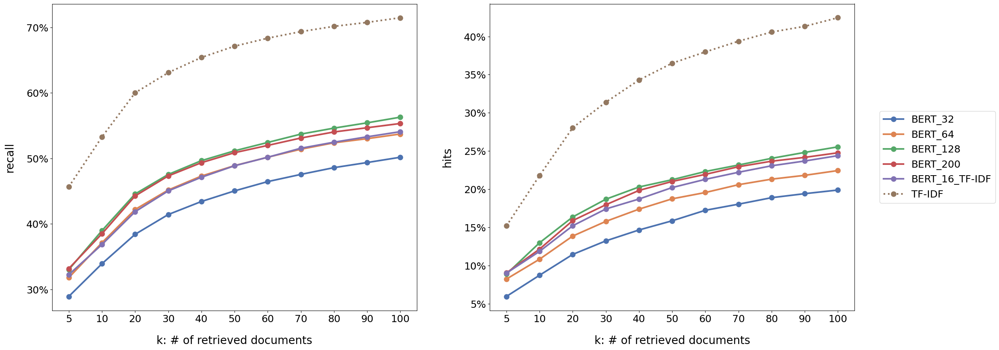

In [7]:
# File suffixes to be used as keys in the dictionary
models = ['bs32', 'bs64', 'bs128', 'bs200', 'bs16_tfidf', 'tfidf']
legend_names = ['BERT_32', 'BERT_64', 'BERT_128', 'BERT_200', 'BERT_16_TF-IDF', 'TF-IDF']

#models = ['tfidf', 'bs128']
#legend_names = ['TF-IDF', 'BERT_128']

label = 'all'

df_dict, df_plot_r, df_plot_hops = read_results_all('recall', models, label, legend_names)
df_dict, df_plot_h, df_plot_hops = read_results_all('hits', models, label, legend_names)


# Define your color schemes for the plots
colors = {}
for i, model in enumerate(df_plot_r.columns):
    colors[i] = sns.color_palette("deep", df_plot_r.shape[1])[i]

# Create a figure and a grid of subplots
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(26, 10))
ax[0] = plot_all(ax[0], df_plot_r, colors, 'recall')
ax[1] = plot_all(ax[1], df_plot_h, colors, 'hits')


#plt.legend(df_plot_r.columns, fontsize=13, bbox_to_anchor=(0.42, -0.2), ncol=6)
plt.legend(df_plot_r.columns,  fontsize=18, loc='right', bbox_to_anchor=(1.4, .5))

#ax[0].set_ylim([0, 0.8])
#ax[1].set_ylim([0, 0.8])

# Save the entire figure as a .png
#plt.savefig(f'/pfs/data5/home/kit/stud/ulhni/nlp_project/plots/metrics_all_pp_bert_tfidf.png', bbox_inches='tight')

# Show the entire figure
plt.show()


## Plot metrics for different hops

In [16]:
from nlp_results import plot_hops

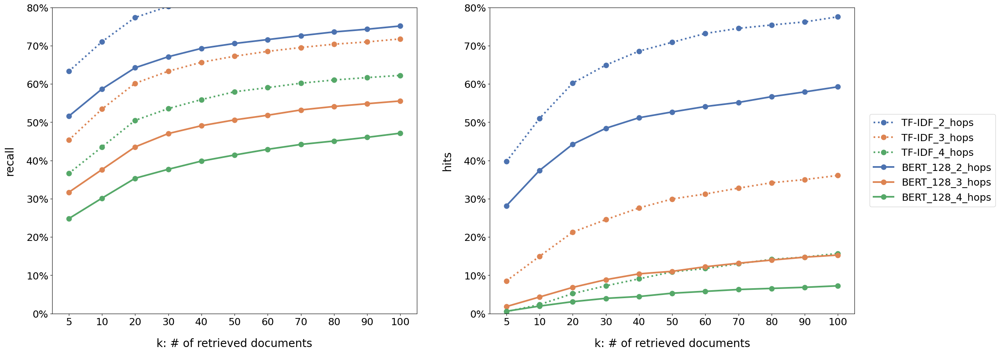

In [73]:
# File suffixes to be used as keys in the dictionary
models = ['bs32', 'bs64', 'bs128', 'bs200', 'bs16_tfidf', 'tfidf']
legend_names = ['BERT_32', 'BERT_64', 'BERT_128', 'BERT_200', 'BERT_16_TF-IDF', 'TF-IDF']

# File suffixes to be used as keys in the dictionary
models = ['bs32', 'bs64', 'bs128', 'tfidf']
legend_names = ['BERT_32', 'BERT_64', 'BERT_128']

label = 'all'

df_dict, df_plot_r, df_plot_hops_r = read_results_all('recall', models, label, legend_names)
df_dict, df_plot_h, df_plot_hops_h = read_results_all('hits', models, label, legend_names)


# Define your color schemes for the plots
colors_hops = {}
for i in np.arange(2,5):
    colors_hops[i] = sns.color_palette("deep", df_plot_hops_r.shape[1])[i-2]

    
# Create a figure and a grid of subplots
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(26, 10))
ax[0] = plot_hops(ax[0], df_plot_hops_r, colors_hops, 'recall')
ax[1] = plot_hops(ax[1], df_plot_hops_h, colors_hops, 'hits')

ax[0].set_ylim([0, 0.8])
ax[1].set_ylim([0, 0.8])

plt.legend(df_plot_hops_r.columns, fontsize=18, loc='right', bbox_to_anchor=(1.4, .5))

# Save the entire figure as a .png
plt.savefig(f'/pfs/data5/home/kit/stud/ulhni/nlp_project/plots/metrics_hops_bert.png', bbox_inches='tight')

# Show the entire figure
plt.show()


In [46]:
# plot for all models
for key in df_dict.keys():
    df_dict

In [76]:
((df_plot['BERT_128_SUP']-df_plot['BERT_128_NOT_SUP'])/df_plot['BERT_128_NOT_SUP']).mean()

0.10066284566525407

## Plot metrics for SUPPORTED and NOT_SUPPORTED Claims

In [36]:
from nlp_results import read_results_label, plot_on_label

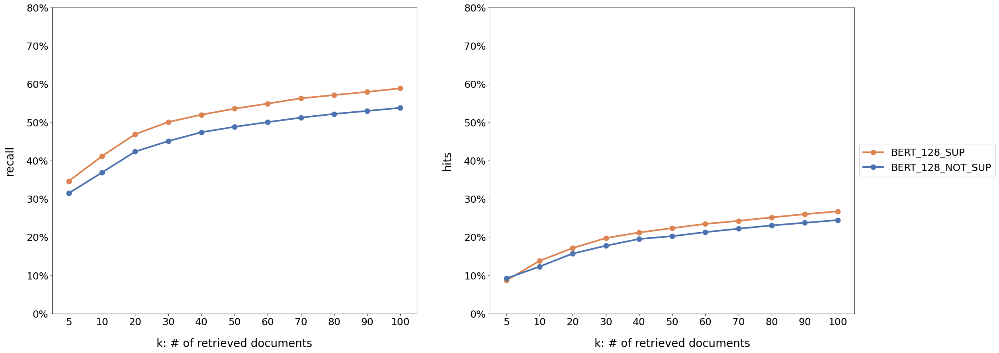

In [71]:
# plots for supported and non supported claims

# File suffixes to be used as keys in the dictionary
models = ['tfidf', 'bs128']
#models = ['bs128']
#names = ['TF-IDF_SUP',  'TF-IDF_NOT_SUP', 'BERT_128_SUP', 'BERT_128_NOT_SUP']
#names = ['BERT_128_SUP', 'BERT_128_NOT_SUP']


df_plot_r, df_plot_hops_r = read_results_label('recall', models, names)
df_plot_h, df_plot_hops_h = read_results_label('hits', models, names)
    
# Define your color schemes for the plots
colors = {}
for i, model in enumerate(df_plot_r.columns):
    colors[i] = sns.color_palette("deep", df_plot_r.shape[1])[i]

# Create a figure and a grid of subplots
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(26, 10))
ax[0] = plot_on_label(ax[0], df_plot_r, 'recall', colors)
ax[1] = plot_on_label(ax[1], df_plot_h, 'hits', colors)

ax[0].set_ylim([0, 0.8])
ax[1].set_ylim([0, 0.8])

plt.legend(df_plot_r.columns, fontsize=18, loc='right', bbox_to_anchor=(1.4, .5))

# Save the entire figure as a .png
plt.savefig(f'/pfs/data5/home/kit/stud/ulhni/nlp_project/plots/metrics_labels_bert', bbox_inches='tight')

# Show the entire figure
plt.show()

In [93]:
# create tables
metric = 'hits'
label = 'NOT_SUPPORTED'
df_metric_32 = pd.read_csv(f'/pfs/data5/home/kit/stud/ulhni/nlp_project/embeddings/results/df_{metric}_bs32_{label}.csv')
df_metric_64 = pd.read_csv(f'/pfs/data5/home/kit/stud/ulhni/nlp_project/embeddings/results/df_{metric}_bs64_{label}.csv')
df_metric_128 = pd.read_csv(f'/pfs/data5/home/kit/stud/ulhni/nlp_project/embeddings/results/df_{metric}_bs128_{label}.csv')
df_metric_200 = pd.read_csv(f'/pfs/data5/home/kit/stud/ulhni/nlp_project/embeddings/results/df_{metric}_bs200_{label}.csv')
df_metric_16_tfidf = pd.read_csv(f'/pfs/data5/home/kit/stud/ulhni/nlp_project/embeddings/results/df_{metric}_bs16_tfidf_{label}.csv')
df_metric_tfidf = pd.read_csv(f'/pfs/data5/home/kit/stud/ulhni/nlp_project/embeddings/results/df_{metric}_tfidf_{label}.csv')

df_metric_32 = df_metric_32.rename(columns={'Unnamed: 0': 'hops'})
df_metric_64 = df_metric_64.rename(columns={'Unnamed: 0': 'hops'})
df_metric_128 = df_metric_128.rename(columns={'Unnamed: 0': 'hops'})
df_metric_200 = df_metric_200.rename(columns={'Unnamed: 0': 'hops'})
df_metric_16_tfidf = df_metric_16_tfidf.rename(columns={'Unnamed: 0': 'hops'})
df_metric_tfidf = df_metric_tfidf.rename(columns={'Unnamed: 0': 'hops'})

df_metric_32['model'] = 'BERT_32'
df_metric_64['model'] = 'BERT_64'
df_metric_128['model'] = 'BERT_128'
df_metric_200['model'] = 'BERT_200'
df_metric_16_tfidf['model'] = 'BERT_16_TF-IDF'
df_metric_tfidf['model'] = 'TF-IDF'

In [94]:
df = pd.concat([df_metric_32, df_metric_64, df_metric_128, df_metric_200, df_metric_16_tfidf, df_metric_tfidf], axis = 0)

df['mean'] = df.mean(axis=1)
df = df.round(decimals=2)
df.set_index(['model', 'hops'], inplace=True)
df.columns = pd.MultiIndex.from_product([['k'], df.columns])

results = df.to_latex(float_format="%.2f", multirow=True)

results = results.replace("[t]", "")
results = results.replace("BERT_", "BERT\_")

print(results)

\begin{tabular}{llrrrrrrrrrrrr}
\toprule
       &     & \multicolumn{12}{l}{k} \\
       &     &    5 &   10 &   20 &   30 &   40 &   50 &   60 &   70 &   80 &   90 &  100 & mean \\
model & hops &      &      &      &      &      &      &      &      &      &      &      &      \\
\midrule
\multirow{4}{*}{BERT\_32} & 2 & 0.20 & 0.26 & 0.33 & 0.35 & 0.38 & 0.41 & 0.42 & 0.45 & 0.48 & 0.48 & 0.49 & 0.39 \\
       & 3 & 0.01 & 0.02 & 0.04 & 0.05 & 0.06 & 0.07 & 0.09 & 0.09 & 0.10 & 0.10 & 0.10 & 0.07 \\
       & 4 & 0.00 & 0.00 & 0.00 & 0.00 & 0.00 & 0.01 & 0.01 & 0.01 & 0.01 & 0.02 & 0.02 & 0.01 \\
       & all & 0.06 & 0.09 & 0.12 & 0.13 & 0.14 & 0.16 & 0.17 & 0.18 & 0.19 & 0.20 & 0.20 & 0.15 \\
\cline{1-14}
\multirow{4}{*}{BERT\_64} & 2 & 0.26 & 0.30 & 0.37 & 0.41 & 0.44 & 0.47 & 0.48 & 0.50 & 0.51 & 0.52 & 0.52 & 0.43 \\
       & 3 & 0.02 & 0.03 & 0.05 & 0.06 & 0.07 & 0.08 & 0.09 & 0.10 & 0.11 & 0.11 & 0.12 & 0.08 \\
       & 4 & 0.00 & 0.00 & 0.00 & 0.01 & 0.02 & 0.02 & 0.02 & 0.02 &

# Create DF with corresponding claim and fact embeddings

In [5]:
# load results from mips
model = 'bs128'
top_k=100
mips_top_indices, mips_top_scores = load_mips_results(model, top_k)

In [6]:
# load hover test dataset
df_hover = prepare_hover_dataset(pd.read_json('hover-main/data/hover/hover_dev_release_v1.1.json'))
df_hover = add_retrieval_ids(df_hover, mips_top_indices)
df_hover = expand_rows(df_hover)
#df_hover = expand_retrieval_ids(df_hover, 10)

100%|██████████| 4000/4000 [00:00<00:00, 15522.26it/s]
4000it [00:00, 6065.26it/s] 


In [7]:
# store the variable, because it we need it later
supporting_fact_id = df_hover['supporting_fact_id'].copy()

In [8]:
df_hover = map_retrieval_ids(df_hover)

In [ ]:
# load embeddings
embeddings_claims, embeddings_wiki = read_data(model)
# map supporting fact id to embedding
df_hover['fact_embedding'] = supporting_fact_id.apply(lambda x: np.array(embeddings_wiki[x]))

In [ ]:
embeddings = torch.load('/pfs/data5/home/kit/stud/ulhni/nlp_project/embeddings/bs128/embeddings_claims.pt')
embeddings = np.array(embeddings)

In [ ]:
df_hover['claim_embedding'] = df_hover_expanded['idx'].apply(lambda x: embeddings[x])

In [ ]:
df_hover.to_pickle('./df_hover_test_fact_embedding.pkl')

In [ ]:
df_hover_expanded = pd.read_pickle('./df_hover_test_fact_embedding.pkl')

In [ ]:
df_hover_expanded

# Reduce Embeddings to 2 dim space

In [4]:
model = 'bs128'

In [142]:
# load embeddings
#embeddings_claims, embeddings_wiki = read_data(model)
#embeddings_claims = np.array(embeddings_claims)
#embeddings_wiki = np.array(embeddings_wiki)

df_hover_expanded = pd.read_pickle('./df_hover_test_fact_embedding.pkl')
embeddings_facts = np.stack(df_hover_expanded['fact_embedding'])
embeddings_claims = np.array(torch.load(f'/home/kit/stud/ulhni/nlp_project/embeddings/{model}/embeddings_claims.pt'))

100%|██████████| 5/5 [07:26<00:00, 89.40s/it]


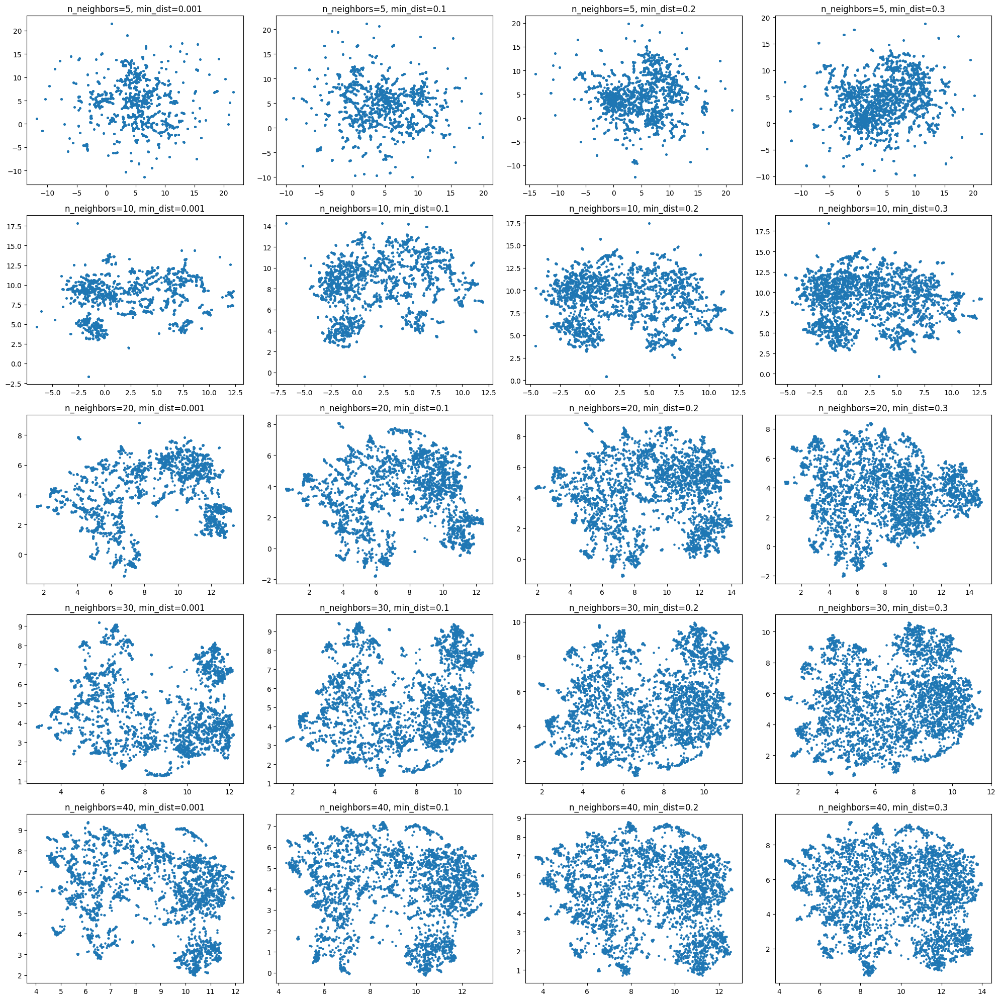

In [215]:
# Tune UMAP model: try out dimensionality reduction for different HP --> choose the one where the structure is most easy to recognize

# Define the hyperparameters we will test
n_neighbors_values = [5, 10, 20, 30, 40]
min_dist_values = [0.001, 0.1, 0.2, 0.3]

fig, axes = plt.subplots(len(n_neighbors_values), len(min_dist_values), figsize=(20, 20))

# Iterate over all combinations of hyperparameters
for i, n_neighbors in enumerate(tqdm(n_neighbors_values)):
    for j, min_dist in enumerate(min_dist_values):
        # Apply UMAP with the current hyperparameters
        umap_model = UMAP(n_neighbors=n_neighbors, n_components=2, min_dist=min_dist, metric='cosine', random_state=60)
        reduced_embeddings = umap_model.fit_transform(embeddings_claims)
    
        # Plot the results
        axes[i, j].scatter(reduced_embeddings[:, 0], reduced_embeddings[:, 1], s=5)
        axes[i, j].set_title(f'n_neighbors={n_neighbors}, min_dist={min_dist}')
        
plt.tight_layout()
plt.show()

100%|██████████| 5/5 [00:01<00:00,  3.80it/s]


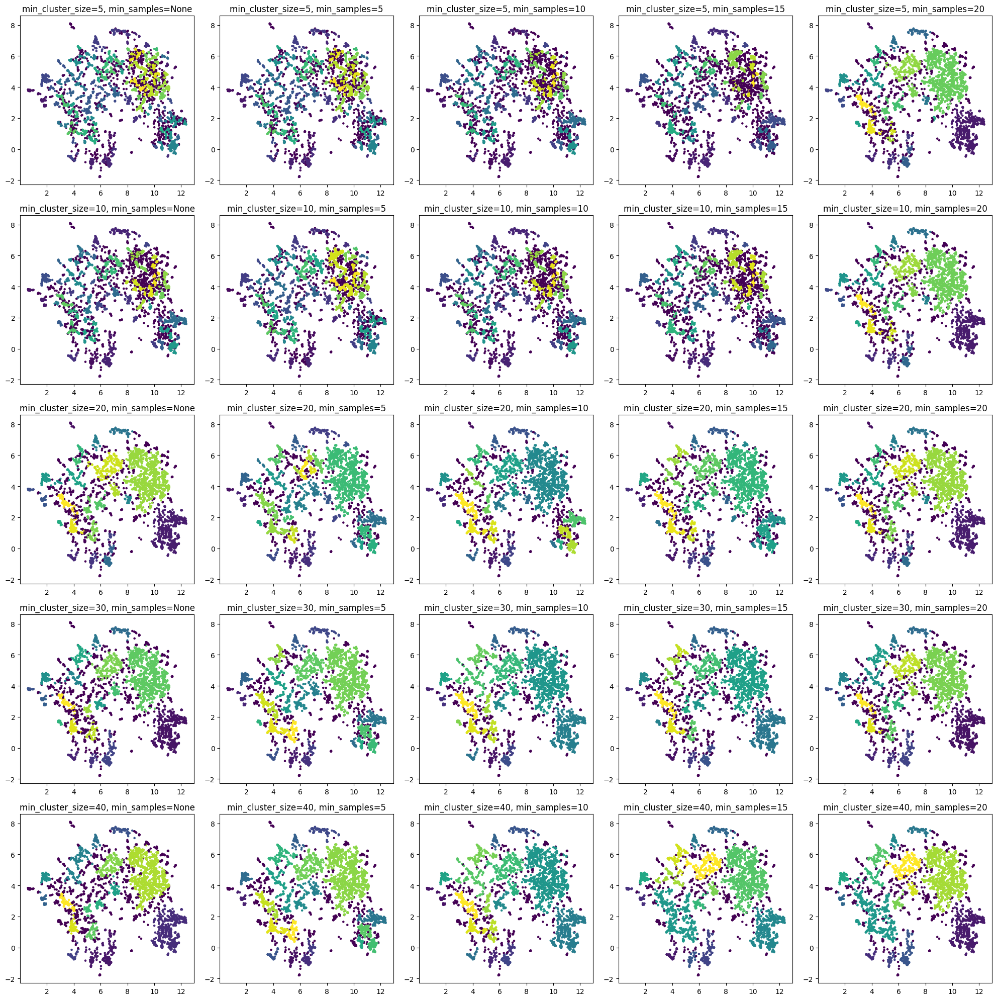

In [217]:
# Apply UMAP with reasonable hyperparameters
umap_model = UMAP(n_neighbors=20, n_components=2, min_dist=0.1, metric='cosine', random_state=60)
reduced_embeddings = umap_model.fit_transform(embeddings_claims)

# Define the hyperparameters we will test
min_cluster_size_values = [5, 10, 20, 30, 40]
min_samples_values = [None, 5, 10, 15, 20]
# The variable alpha_values is not used in HDBSCAN.

# Prepare for the plot
fig, axes = plt.subplots(len(min_cluster_size_values), len(min_samples_values), figsize=(20, 20))

# Iterate over all combinations of hyperparameters
for i, min_cluster_size in enumerate(tqdm(min_cluster_size_values)):
    for j, min_samples in enumerate(min_samples_values):
        # Cluster with HDBSCAN
        clusterer = HDBSCAN(min_cluster_size=min_cluster_size, min_samples=min_samples, metric='euclidean', cluster_selection_method='eom')
        cluster_labels = clusterer.fit_predict(reduced_embeddings)

        # Plot the results
        axes[i, j].scatter(reduced_embeddings[:, 0], reduced_embeddings[:, 1], c=cluster_labels, cmap='viridis', s=5)
        axes[i, j].set_title(f'min_cluster_size={min_cluster_size}, min_samples={min_samples}')

plt.tight_layout()
plt.show()


In [144]:
#fit reasonable umap
umap = UMAP(n_neighbors=20, n_components=2, min_dist=0.1, metric='cosine', random_state=60).fit(embeddings_claims)

# reduce claim and fact embeddings
reduced_claim_embeddings = umap.transform(embeddings_claims) 
reduced_fact_embeddings = umap.transform(embeddings_facts) 

del embeddings_claims
del embeddings_facts

np.save(f'reduced_embeddings/reduced_embeddings_claims.npy', reduced_claim_embeddings)
np.save(f'reduced_embeddings/reduced_embeddings_facts.npy', reduced_fact_embeddings)

In [ ]:
# reduce wiki embeddings. Do it in batches. Only sample 850_000 articles because dimensionality reduction is resource intensive

# Number of random rows you want to sample
n= 1_000_000

# Generate n random indices
random_indices = np.random.choice(embeddings_wiki.shape[0], size=n, replace=False)

# Index into the array to get the random rows
embeddings_wiki = embeddings_wiki[random_indices, :]

# Assuming embeddings is your original data
n_samples, n_features = embeddings_wiki.shape
batch_size = 10000  # size of batches for transformation

# Transform in batches
reduced_embeddings_wiki = np.zeros((n_samples, 2))  # Prepare an array to store the results
for i in tqdm(range(0, n_samples, batch_size)):
    batch_indices = np.arange(i, min(i + batch_size, n_samples))
    reduced_embeddings_wiki[batch_indices] = umap.transform(embeddings_wiki[batch_indices])    
    # To save it in a binary format .npy
    np.save(f'reduced_embeddings/reduced_embeddings_wiki.npy', reduced_embeddings_wiki)

In [145]:
# load the reduced embeddings
#reduced_embeddings_wiki = np.load('reduced_embeddings/reduced_embeddings_wiki.npy')[:850_000]
reduced_claim_embeddings = np.load('reduced_embeddings/reduced_embeddings_claims.npy')
reduced_fact_embeddings = np.load('reduced_embeddings/reduced_embeddings_facts.npy')

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from matplotlib.colors import LinearSegmentedColormap


# Set up the figure size
plt.figure(figsize=(15, 10))


# Then, plot the colored dots
plt.scatter(reduced_embeddings_wiki[:,0], reduced_embeddings_wiki[:,1], alpha=0.5, s=20, color='green')


# Then, plot the colored dots
plt.scatter(reduced_fact_embeddings[:,0], reduced_fact_embeddings[:,1], alpha=0.5, s=20, color='blue')


# First, plot the light gray dots
plt.scatter(reduced_claim_embeddings[:,0], reduced_claim_embeddings[:,1], alpha=0.9, s=20, color='red')


# Set the title and labels
plt.title('Claims, relevant Docs, and Wiki DB')
plt.xlabel('D1')
plt.ylabel('D2')

# Show the plot
plt.show()

## Prepare df_hover and df_tfidf dataset

In [97]:
from nlp_results import *

In [98]:
model = 'bs128'
top_k = 100

In [99]:
mips_top_indices, mips_top_scores = load_mips_results(model, top_k)

In [100]:
top_k = 5

df_hover = prepare_hover_dataset(pd.read_json('hover-main/data/hover/hover_dev_release_v1.1.json'))
df_hover = add_retrieval_ids(df_hover, mips_top_indices)
df_hover = calculate_matches(df_hover, top_k=top_k)
# load_DB and create dictionary which maps article names to their corresponding indexes
df_DB, article_name_index_map = load_wiki_DB(create_mapping=True) 

100%|██████████| 4000/4000 [00:00<00:00, 15680.02it/s]


In [101]:
df_hover = map_documents(df_DB, df_hover, mips_top_indices[:,:top_k])
df_hover = add_relevancy_info(df_hover, top_k)
df_hover['recall'] = df_hover['number_of_matches']/df_hover['num_hops']
df_hover['claim_length']=df_hover['claim'].apply(lambda x: len(x.split()))

100%|██████████| 4000/4000 [00:03<00:00, 1266.06it/s]


In [103]:
df_hover['hits']=(df_hover['number_of_matches']==df_hover['num_hops']).astype(int)

In [104]:
df_hover[['claim_length', 'recall']].corr()

,claim_length,recall
claim_length,1.000000,-0.143969
recall,-0.143969,1.000000


In [105]:
df_tfidf=prepare_tfidf_dataset(pd.read_json('/home/kit/stud/ulhni/nlp_project/hover-main/data/hover/tfidf_retrieved/dev_tfidf_doc_retrieval_results.json'))
df_tfidf=calculate_matches(df_tfidf, top_k=top_k)
df_tfidf['recall'] = df_tfidf['number_of_matches']/df_tfidf['num_hops']
df_tfidf['hits']=(df_tfidf['number_of_matches']==df_tfidf['num_hops']).astype(int)

100%|██████████| 4000/4000 [00:00<00:00, 7483.91it/s]


In [106]:
tfidf_top_indices = torch.tensor(df_tfidf['retrieval_ids'])[:,:top_k]

In [107]:
df_DB, article_name_index_map = load_wiki_DB(create_mapping=True) 
df_tfidf = map_documents(df_DB, df_tfidf, tfidf_top_indices)
df_tfidf = add_relevancy_info(df_tfidf, top_k)

100%|██████████| 4000/4000 [00:03<00:00, 1296.52it/s]


In [110]:
df_tfidf['claim_length']=df_tfidf['claim'].apply(lambda x: len(x.split()))
df_tfidf[['claim_length', 'recall']].corr()

,claim_length,recall
claim_length,1.000000,0.058702
recall,0.058702,1.000000


In [111]:
del df_DB

In [14]:
df_rank_hover = get_rank_supporting_facts(df_hover, mips_top_indices)

100%|██████████| 4000/4000 [00:04<00:00, 912.09it/s] 


### Classify articles with BERTopic

In [18]:
# sentence_model = SentenceTransformer("all-MiniLM-L6-v2")
# embeddings = sentence_model.encode(docs, show_progress_bar=True)

In [112]:
# Train BERTopic
claims = df_hover['claim']
embeddings = torch.load('/pfs/data5/home/kit/stud/ulhni/nlp_project/embeddings/bs128/embeddings_claims.pt')
embeddings = np.array(embeddings)

umap_model = UMAP(n_neighbors=20, n_components=2, min_dist=0.1, metric='cosine', random_state=60)
hdbscan_model = HDBSCAN(min_cluster_size=40, min_samples=10, metric='euclidean', cluster_selection_method='eom', prediction_data=True)
topic_model = BERTopic(hdbscan_model=hdbscan_model, umap_model=umap_model).fit(claims, embeddings)

In [113]:
# Get topics for each document
topics, probs = topic_model.transform(claims, embeddings)

In [114]:
from sklearn.feature_extraction.text import CountVectorizer

# remove stop words when creating topics
vectorizer_model = CountVectorizer(stop_words="english")
topic_model.update_topics(claims, vectorizer_model=vectorizer_model)
topics, probabilities = topic_model.topics_, topic_model.probabilities_

In [115]:
# reducde number of topics
#topic_model.reduce_topics(docs, nr_topics=40)
# Access updated topics
#topics, probabilities = topic_model.topics_, topic_model.probabilities_

In [116]:
df = pd.DataFrame(data={'claim': df_hover['claim'], 
                        'bert_recall':df_hover['recall'],
                        'bert_hits':df_hover['hits'],
                        'bert_number_of_matches':df_hover['number_of_matches'], 
                        'tfidf_recall':df_tfidf['recall'], 
                        'tfidf_hits':df_tfidf['hits'], 
                        'tfidf_number_of_matches':df_tfidf['number_of_matches'], 
                        'number_of_hops':df_hover['num_hops'], 
                        'diff_recall': df_hover['recall']-df_tfidf['recall'],
                        'diff_hits': df_hover['hits']-df_tfidf['hits'],
                        'claim_length':df_hover['claim_length'], 
                        'topic':topics 
                        })

In [117]:
topic_dict = {}
for topic in topics:
    topic_words = topic_model.get_topic(topic)
    # Here we'll name the topic after the three most representative words
    topic_name = "_".join(word[0] for word in topic_words[:3])
    topic_dict[topic] = topic_name

df['topic_name'] = df['topic'].map(topic_dict)

In [118]:
occurences = df.groupby('topic_name').count()['claim']

In [119]:
df_agg = df.groupby('topic_name').mean().sort_values('bert_recall')
df_agg = np.round(df_agg,2)
df_agg['number_of_claims'] = occurences
df_agg

,bert_recall,bert_hits,bert_number_of_matches,tfidf_recall,tfidf_hits,tfidf_number_of_matches,number_of_hops,diff_recall,diff_hits,claim_length,topic,number_of_claims
topic_name,,,,,,,,,,,,
indian_award_ceremony,0.22,0.02,0.58,0.55,0.22,1.52,2.93,-0.33,-0.20,24.81,7.0,97
car_formula_racing,0.27,0.03,0.79,0.44,0.06,1.40,3.26,-0.17,-0.03,31.91,15.0,68
railway_located_cathedral,0.29,0.07,0.84,0.48,0.13,1.42,3.11,-0.18,-0.05,25.27,3.0,166
university_college_private,0.31,0.05,0.82,0.37,0.05,1.08,3.00,-0.07,0.00,23.35,16.0,65
tennis_doubles_partner,0.33,0.04,1.01,0.25,0.00,0.76,3.29,0.08,0.04,25.68,11.0,84
dog_city_cities,0.33,0.07,0.95,0.49,0.12,1.50,3.13,-0.16,-0.05,21.50,8.0,92
film_director_actor,0.34,0.07,0.97,0.46,0.13,1.32,3.03,-0.12,-0.06,25.13,0.0,1066
team_nba_coach,0.34,0.12,0.84,0.41,0.12,1.04,2.70,-0.06,0.00,25.74,12.0,81
band_album_song,0.35,0.06,1.04,0.41,0.09,1.23,3.12,-0.06,-0.03,25.42,1.0,551


In [120]:
from scipy.stats import spearmanr

x = df_agg['bert_hits']
y = df_agg['tfidf_hits']

# Calculate Spearman correlation coefficient and p-value
correlation_coefficient, p_value = spearmanr(x, y)

# Print the results
print("Spearman correlation coefficient:", np.round(correlation_coefficient, 4))
print("P-value:", np.round(p_value, 4))

Spearman correlation coefficient: 0.5676
P-value: 0.009


In [121]:
from scipy.stats import spearmanr

x = df_agg['bert_recall']
y = df_agg['tfidf_recall']

# Calculate Spearman correlation coefficient and p-value
correlation_coefficient, p_value = spearmanr(x, y)

# Print the results
print("Spearman correlation coefficient:", np.round(correlation_coefficient, 4))
print("P-value:", np.round(p_value, 4))

Spearman correlation coefficient: 0.6218
P-value: 0.0034


In [122]:
df_hover['recall'] = df_hover['recall'].round(2)
df_tfidf['recall'] = df_tfidf['recall'].round(2)
df_hover['hits'] = df_hover['hits'].round(2)
df_tfidf['hits'] = df_tfidf['hits'].round(2)

In [ ]:
# Reduce dimensionality of embeddings, this step is optional but much faster to perform iteratively:
reduced_claim_embeddings = umap_model.transform(embeddings_claims)
reduced_fact_embeddings = umap_model.transform(embeddings_facts)

In [ ]:
np.save('reduced_embeddings/reduced_embeddings_claims.npy', reduced_claim_embeddings)
np.save('reduced_embeddings/reduced_embeddings_facts.npy', reduced_fact_embeddings)

In [123]:
df_hover_expanded = pd.read_pickle('./df_hover_test_fact_embedding.pkl')
embeddings_facts = np.stack(df_hover_expanded['fact_embedding'])
embeddings_claims = np.array(torch.load(f'/home/kit/stud/ulhni/nlp_project/embeddings/{model}/embeddings_claims.pt'))

In [124]:
reduced_claim_embeddings = np.load('reduced_embeddings/reduced_embeddings_claims.npy')
reduced_fact_embeddings = np.load('reduced_embeddings/reduced_embeddings_facts.npy')

# get example claim for qualitative analysis

In [153]:
claim1_bert = df_hover[df_hover['claim'].str.contains('Age of Chance and Vector were both a rock band')]
claim1_tfidf = df_tfidf[df_tfidf['claim'].str.contains('Age of Chance and Vector were both a rock band')]
claim2_bert = df_hover[df_hover['claim'].str.contains('Apple Inc. and manufactured by Samsung beginning in 1997.')]
claim2_tfidf = df_tfidf[df_tfidf['claim'].str.contains('Apple Inc. and manufactured by Samsung beginning in 1997.')]

In [156]:
pd.set_option('display.max_colwidth', None)
claim2_tfidf.loc[:,'retrieved_doc_1':]

,retrieved_doc_1,retrieved_doc_2,retrieved_doc_3,retrieved_doc_4,retrieved_doc_5,claim_length
2057,"T - Jim Keller (engineer) [SEP] Jim Keller is a microprocessor engineer most well known for his work at AMD and Apple. He was the lead architect of the AMD K8 microarchitecture (including the original Athlon 64) and was involved in designing the Athlon (K7) and Apple A4/A5 processors. He was also the coauthor of the specifications for the x86-64 instruction set and HyperTransport interconnect. From 2012 to 2015, he returned to AMD to work on the AMD K12 and Zen microarchitectures.","T - Apple A4 [SEP] The Apple A4 is a 32-bit package on package (PoP) system-on-a-chip (SoC) designed by Apple Inc. and manufactured by Samsung. It combines an ARM Cortex-A8 CPU with a PowerVR GPU, and emphasizes power efficiency. The chip commercially debuted with the release of Apple's iPad tablet; followed shortly by the iPhone 4 smartphone, the iPod Touch (4th generation), and the Apple TV (2nd generation). It was superseded by the Apple A5 processor used in the iPad 2 released the following year, which was then subsequently replaced by the Apple A5X processor in the iPad (3rd generation).","F - Apple A5 [SEP] The Apple A5 is a 32-bit system-on-a-chip designed by Apple Inc. and manufactured by Samsung and is the successor to the Apple A4. The A5 commercially debuted with the release of Apple's iPad 2 tablet, and also powers the iPhone 4S, iPod Touch fifth generation, Apple TV third generation, and the iPad mini. This is consistent with how Apple debuted the A4 chip: first in the original iPad, followed by the iPhone 4, and then the iPod Touch (fourth generation). Apple claims that compared to its predecessor, the A4, the A5 CPU ""can do twice the work"" and the GPU has ""up to nine times the graphics performance"".","F - Apple A9 [SEP] The Apple A9 is a 64-bit ARM-based system-on-chip (SoC), designed by Apple Inc. Manufactured for Apple by both TSMC and Samsung, it first appeared in the iPhone 6S and 6S Plus which were introduced on September 9, 2015. Apple stated that it had 70% more CPU performance and 90% more graphics performance compared to its predecessor, the Apple A8, and was one of the most powerful and energy-efficient mobile chips on the market then along with the Samsung Exynos 8890 and Qualcomm Snapdragon 820.","F - Apple A10 [SEP] The Apple A10 Fusion is a 64-bit ARM-based system on a chip (SoC), designed by Apple Inc. and manufactured by TSMC. It first appeared in the iPhone 7 and 7 Plus which were introduced on September 7, 2016. The A10 is the first Apple-designed quad-core SoC, with two high-performance cores and two energy-efficient cores. Apple states that it has 40% greater CPU performance and 50% greater graphics performance compared to its predecessor, the Apple A9.",40


# Claims Hits and Recall

In [125]:
from nlp_results import figure_layout, create_hover_text
import plotly.graph_objects as go
import numpy as np
import pandas as pd
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.pyplot as plt

In [126]:
# only keep unqiue facts
mask=np.array(df_hover_expanded['supporting_fact_id'].drop_duplicates().index)

In [127]:
colorization_metric = df_hover['hits']

#colorization_metric = df_hover['hits'] - df_tfidf['hits']

cmap = plt.get_cmap('RdYlGn')
min_recall = min(colorization_metric)
max_recall = max(colorization_metric)
norm = plt.Normalize(min_recall, max_recall)
colors = cmap(norm(colorization_metric))

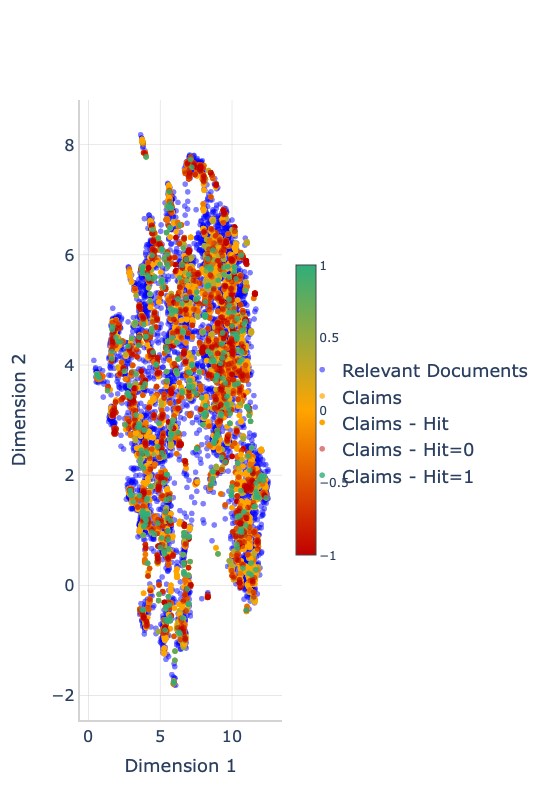

In [39]:
mask_recall_0 = df_hover['recall']==0
mask_recall_1 = df_hover['recall']==1

marker_size = 6
fig = go.Figure()

# add facts 
fig.add_trace(
    go.Scatter(
        x=reduced_fact_embeddings[:,0][mask],
        y=reduced_fact_embeddings[:,1][mask],
        mode='markers',
        marker=dict(
            size=marker_size,
            color='blue',  # Set color to the recall
            #colorscale='RdYlGn',  # Use the desired colorscale
            #showscale=True
            opacity=0.5
        ),
        text=df_hover_expanded['supporting_fact_id'][mask],  # This will be displayed when hovering over points
        name='Relevant Documents'
    )
)

# add all claims in red
fig.add_trace(
    go.Scatter(
        x=reduced_claim_embeddings[:,0],
        y=reduced_claim_embeddings[:,1],
        mode='markers',
        marker=dict(
            size=marker_size,
            color='orange',
            opacity=0.7
        ),
        text=df_hover['claim'],  # This will be displayed when hovering over points
        name='Claims'
    )
)

# add all claims with recall colorbar
fig.add_trace(
    go.Scatter(
        x=reduced_claim_embeddings[:,0],
        y=reduced_claim_embeddings[:,1],
        mode='markers',
        marker=dict(
            size=marker_size,
            color=colorization_metric,  # Set color to the recall
            colorscale=[(0, '#C00000'), (0.5,'orange'), (1, '#2FAE7A')],  # Use the desired colorscale
            showscale=True,
            colorbar=dict(
                thickness=20,  # Adjust the width of the color scale
                len=0.5,  # Adjust the height of the color scale
            ),
        ),
        text=df_hover['claim'],  # This will be displayed when hovering over points
        name='Claims - Hit'
    )
)

# add all claims with 0 recall
fig.add_trace(
    go.Scatter(
        x=reduced_claim_embeddings[:,0][mask_recall_0],
        y=reduced_claim_embeddings[:,1][mask_recall_0],
        mode='markers',
        marker=dict(
            size=marker_size,
            color='#C00000',
             opacity=0.5
        ),
        text=df_hover['claim'][mask_recall_0],  # This will be displayed when hovering over points
        name='Claims - Hit=0'
    )
)

# add all claims with 1 recall
fig.add_trace(
    go.Scatter(
        x=reduced_claim_embeddings[:,0][mask_recall_1],
        y=reduced_claim_embeddings[:,1][mask_recall_1],
        mode='markers',
        marker=dict(
            size=marker_size,
            color='#2FAE7A',
            opacity=0.8
        ),
        text=df_hover['claim'][mask_recall_1],  # This will be displayed when hovering over points
        name='Claims - Hit=1'
    )
)


# Set the title and labels
fig = figure_layout(fig)


fig.show()


In [80]:
import plotly.io as pio

pio.write_html(fig, 'plots/claims_hits.html')

# Claims BERT Tfidf Comparison

In [30]:
#colorization_metric = df_hover['recall']
#colorization_metric = df_hover['hits'] - df_tfidf['hits']
colorization_metric = df_hover['recall'] - df_tfidf['recall']
#name = 'Bert_hits - TFIDF_hits'
name = 'Bert_recall - TFIDF_recall'

cmap = plt.get_cmap('RdYlGn')
min_metric = min(colorization_metric)
max_metric= max(colorization_metric)
norm = plt.Normalize(min_metric, max_metric)
colors = cmap(norm(colorization_metric))

mask_metric_min = colorization_metric == min_metric
mask_metric_max = colorization_metric == max_metric

In [31]:
sum(mask_metric_max)

16

In [ ]:
# prepare hover text
df.loc[df['topic'] == -1, 'topic_name'] = 'no_topic'
df_hover['topic_name']=df['topic_name'].copy()

hover_text = create_hover_text(df_hover, df_tfidf, max_len=220)

df_hover['hover_text'] = hover_text
  
marker_size = 6
fig = go.Figure()

# add facts 
fig.add_trace(
    go.Scatter(
        x=reduced_fact_embeddings[:,0][mask],
        y=reduced_fact_embeddings[:,1][mask],
        hoverinfo='text', 
        mode='markers',
        marker=dict(
            size=marker_size,
            color='blue',  # Set color to the recall
            #colorscale='RdYlGn',  # Use the desired colorscale
            #showscale=True
            opacity=0.5
        ),
        text=df_hover_expanded['supporting_fact_id'][mask],  # This will be displayed when hovering over points
        name='Relevant Documents'
    )
)

# add all claims in orange
fig.add_trace(
    go.Scatter(
        x=reduced_claim_embeddings[:,0],
        y=reduced_claim_embeddings[:,1],
        hoverinfo='text', 
        mode='markers',
        marker=dict(
            size=marker_size,
            color='orange',
            opacity=0.7
        ),
        text=hover_text,  # This will be displayed when hovering over points
        name='Claims'
    )
)

# add all claims with recall colorbar
fig.add_trace(
    go.Scatter(
        x=reduced_claim_embeddings[:,0],
        y=reduced_claim_embeddings[:,1],
        hoverinfo='text', 
        mode='markers',
        marker=dict(
            size=marker_size,
            color=colorization_metric,  # Set color to the recall
            colorscale=[(0, '#C00000'), (0.5,'orange'), (1, '#2FAE7A')],  # Use the desired colorscale
            showscale=True,
            cmin = min_metric,
            cmax = max_metric,
            colorbar=dict(
                thickness=20,  # Adjust the width of the color scale
                len=0.5,  # Adjust the height of the color scale
            ),
        ),
        text=hover_text,  # This will be displayed when hovering over points
        name=f'Claims: {name}'
    )
)

# add all claims with 0 recall
fig.add_trace(
    go.Scatter(
        x=reduced_claim_embeddings[:,0][mask_metric_min],
        y=reduced_claim_embeddings[:,1][mask_metric_min],
        mode='markers',
        hoverinfo='text', 
        marker=dict(
            size=marker_size,
            color='#C00000',
             opacity=0.5
        ),
        text=hover_text[mask_metric_min],  # This will be displayed when hovering over points
        name=f'Claims: {name} = -1'
    )
)

# add all claims with 1 recall
fig.add_trace(
    go.Scatter(
        x=reduced_claim_embeddings[:,0][mask_metric_max],
        y=reduced_claim_embeddings[:,1][mask_metric_max],
        hoverinfo='text', 
        mode='markers',
        marker=dict(
            size=marker_size,
            color='#2FAE7A',
            opacity=0.8
        ),
        text=hover_text[mask_metric_max],  # This will be displayed when hovering over points
        name=f'Claims: {name} = 1'
    )
)

# Set the title and labels
fig = figure_layout(fig)

fig.show()

In [60]:
pio.write_html(fig, 'plots/claims_recall_comparison.html')

# Plot Vector article

In [35]:
df_hover_expanded[df_hover_expanded['claim'].str.contains('Vector')]

,idx,claim,retrieval_ids,label,supporting_fact_id,fact_embedding,claim_embedding
148,74,Age of Chance and Vector were both a rock band.,"[808008.0, 4169652.0, 4741654.0, 335548.0, 196...",1,Vector (band) [SEP] Vector was a rock band for...,"[0.0386234, -0.015983786, -0.019426161, -0.023...","[0.06363293, -0.026944838, -0.06699299, 0.0232..."
149,74,Age of Chance and Vector were both a rock band.,"[808008.0, 4169652.0, 4741654.0, 335548.0, 196...",1,Age of Chance [SEP] Age of Chance were a Briti...,"[-0.04376982, 0.061818574, 0.04063394, -0.0081...","[0.06363293, -0.026944838, -0.06699299, 0.0232..."
485,238,The group that released One Thousand Years of ...,"[3008643.0, 3199315.0, 3898091.0, 3291472.0, 3...",1,One Thousand Years of Trouble [SEP] One Thousa...,"[-0.09341547, 0.13948025, 0.001603465, -0.0319...","[0.034672797, -0.019868169, -0.017493797, -0.0..."
486,238,The group that released One Thousand Years of ...,"[3008643.0, 3199315.0, 3898091.0, 3291472.0, 3...",1,Vector (band) [SEP] Vector was a rock band for...,"[0.0386234, -0.015983786, -0.019426161, -0.023...","[0.034672797, -0.019868169, -0.017493797, -0.0..."
487,238,The group that released One Thousand Years of ...,"[3008643.0, 3199315.0, 3898091.0, 3291472.0, 3...",1,Age of Chance [SEP] Age of Chance were a Briti...,"[-0.04376982, 0.061818574, 0.04063394, -0.0081...","[0.034672797, -0.019868169, -0.017493797, -0.0..."
6792,2352,The quartets that released One Thousand Years ...,"[3291472.0, 3898091.0, 3199315.0, 1524514.0, 3...",-1,One Thousand Years of Trouble [SEP] One Thousa...,"[-0.09341547, 0.13948025, 0.001603465, -0.0319...","[0.027188493, -0.003438385, -0.013344703, -0.0..."
6793,2352,The quartets that released One Thousand Years ...,"[3291472.0, 3898091.0, 3199315.0, 1524514.0, 3...",-1,Vector (band) [SEP] Vector was a rock band for...,"[0.0386234, -0.015983786, -0.019426161, -0.023...","[0.027188493, -0.003438385, -0.013344703, -0.0..."
6794,2352,The quartets that released One Thousand Years ...,"[3291472.0, 3898091.0, 3199315.0, 1524514.0, 3...",-1,Age of Chance [SEP] Age of Chance were a Briti...,"[-0.04376982, 0.061818574, 0.04063394, -0.0081...","[0.027188493, -0.003438385, -0.013344703, -0.0..."


In [36]:
idx = article_name_index_map["Vector Laplacian"]

In [37]:
idx

1724182

In [45]:
title = "Vector Laplacian"
# retrieve article text

conn = sqlite3.connect('/home/kit/stud/ulhni/nlp_project/hover-main/data/wiki_wo_links.db')
cursor = conn.cursor()

cursor.execute("SELECT text FROM documents WHERE id = ?", (unicodedata.normalize('NFD', title),))
result = cursor.fetchall()
laplace_description = result[0][0]

conn.close()

In [46]:
laplace_description

'In mathematics and physics, the vector Laplace operator, denoted by formula_1, named after Pierre-Simon Laplace, is a differential operator defined over a vector field. The vector Laplacian is similar to the scalar Laplacian. Whereas the scalar Laplacian applies to a scalar field and returns a scalar quantity, the vector Laplacian applies to a vector field, returning a vector quantity. When computed in orthonormal Cartesian coordinates, the returned vector field is equal to the vector field of the scalar Laplacian applied to each vector component.'

In [ ]:
embeddings_claims, embeddings_wiki = read_data(model)

In [ ]:
embeddings_laplace = embeddings_wiki[1724182]

In [ ]:
del embeddings_claims, embeddings_wiki

In [ ]:
reduced_embedding_laplace = umap_model.transform(np.array(embeddings_laplace).reshape(1,-1)).flatten()

In [ ]:
reduced_embedding_laplace

array([5.8057966, 4.4462085], dtype=float32)

In [38]:
reduced_embedding_laplace = np.array([5.8057966, 4.4462085])

In [39]:
reduced_embedding_rock_band = reduced_fact_embeddings[148]

In [40]:
reduced_embedding_rock_band

array([10.909328  ,  0.42699924], dtype=float32)

In [41]:
# actual article
reduced_embedding_article = reduced_claim_embeddings[74]

In [42]:
band_description = df_hover_expanded['supporting_fact_id'][148]

/scratch/slurm_tmpdir/job_22450161/ipykernel_363292/3452104568.py:10: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



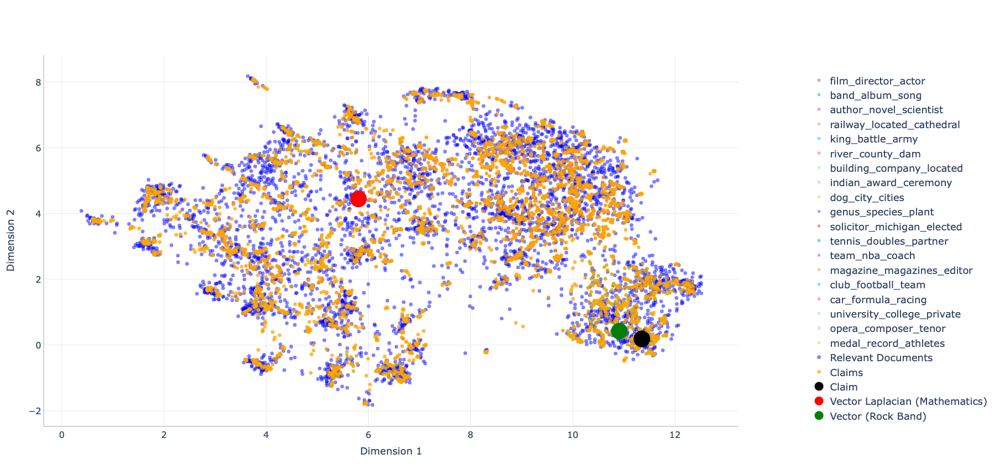

In [56]:
marker_size=7

# Get a list of unique topics
topics_sorted = df['topic'].unique()

# Sort topics by recall for legend
topics_sorted = list(df.groupby('topic').mean().sort_values('bert_recall', ascending=False).index)

# Create a colormap with the same number of colors as there are unique topics
colormap = matplotlib.cm.get_cmap('viridis', len(topics_sorted))

# Create a color dictionary mapping each topic to a color
color_dict = {topic: colormap(i) for i, topic in enumerate(topics_sorted)}


# prepare hover text
df.loc[df['topic'] == -1, 'topic_name'] = 'no_topic'
df_hover['topic_name']=df['topic_name'].copy()
hover_text = df_hover.apply(lambda row: f"Topic: {row['topic_name']}<br>Recall: {row['recall']}<br>Claim: {row['claim']}", axis=1)



topic_dict = dict(zip(df['topic'], df['topic_name']))

recall_dict = dict(df.groupby('topic').agg(['mean']).sort_values([('bert_recall', 'mean')])[('bert_recall', 'mean')])
min_recall = min(recall_dict.values())
max_recall = max(recall_dict.values())


# Set up the figure size
fig = go.Figure()

# First, plot the light gray dots
gray_mask = df['topic'] == -1
fig.add_trace(go.Scatter(
                        x=reduced_claim_embeddings[:,0][gray_mask],
                        y=reduced_claim_embeddings[:,1][gray_mask],
                        mode='markers', 
                        marker=dict(color='lightgray', size=5, opacity=0.5),
                        text=hover_text[gray_mask], # This will be displayed when hovering over points
                        hoverinfo='text', 
                        showlegend=False
))

color_dict = {topic: recall for topic, recall in recall_dict.items()}
# Map 'bert_recall' values to colors
df['color'] = df['topic'].apply(lambda x: color_dict[x])

# sort by count
topics = list(df.groupby('topic').count().sort_values('bert_recall', ascending=False).index)


for topic in topics:
    if topic != -1:
        # Then, plot the colored dots
        colored_mask = df['topic'] == topic

        fig.add_trace(go.Scatter(
                                 x=reduced_claim_embeddings[:,0][colored_mask],
                                 y=reduced_claim_embeddings[:,1][colored_mask],
                                 mode='markers',
                                 text=hover_text[colored_mask],
                                 name=topic_dict[topic],
                                 hoverinfo='text',
                                 marker=dict(
                                     color=color_dict[topic],  # Assign color from color_dict
                                     size=6,
                                     opacity=0.6),
                                 showlegend=True
                                ))

# add facts 
fig.add_trace(
    go.Scatter(
        x=reduced_fact_embeddings[:,0][mask],
        y=reduced_fact_embeddings[:,1][mask],
        hoverinfo='text', 
        mode='markers',
        marker=dict(
            size=marker_size,
            color='blue',  # Set color to the recall
            #colorscale='RdYlGn',  # Use the desired colorscale
            #showscale=True
            opacity=0.5
        ),
        text=df_hover_expanded['supporting_fact_id'][mask],  # This will be displayed when hovering over points
        name='Relevant Documents'
    )
)

# add all claims in orange
fig.add_trace(
    go.Scatter(
        x=reduced_claim_embeddings[:,0],
        y=reduced_claim_embeddings[:,1],
        hoverinfo='text', 
        mode='markers',
        marker=dict(
            size=marker_size,
            color='orange',
            opacity=0.7
        ),
        text=hover_text,  # This will be displayed when hovering over points
        name='Claims'
    )
)


# add article Age of Chance and Vectore were both a rock band
fig.add_trace(
    go.Scatter(
        x=[reduced_embedding_article[0]],
        y=[reduced_embedding_article[1]],
        hoverinfo='text', 
        mode='markers',
        marker=dict(
            size=30,
            color='Black',
            opacity=1
        ),
        text='Age of Chance and Vectore were both a rock band',  # This will be displayed when hovering over points
        name='Claim'
    )
)

# add article Age of Chance and Vectore were both a rock band
fig.add_trace(
    go.Scatter(
        x=[reduced_embedding_laplace[0]],
        y=[reduced_embedding_laplace[1]],
        hoverinfo='text', 
        mode='markers',
        marker=dict(
            size=30,
            color='Red',
            opacity=1
        ),
        text=laplace_description,  # This will be displayed when hovering over points
        name='Vector Laplacian (Mathematics)'
    )
)

# add article Age of Chance and Vectore were both a rock band
fig.add_trace(
    go.Scatter(
        x=[reduced_embedding_rock_band[0]],
        y=[reduced_embedding_rock_band[1]],
        hoverinfo='text', 
        mode='markers',
        marker=dict(
            size=30,
            color='Green',
            opacity=1
        ),
        text=band_description,  # This will be displayed when hovering over points
        name='Vector (Rock Band)'
    )
)

# Set the title and labels
fig = figure_layout(fig, width=1500, height=850)

fig.show()

In [55]:
import plotly.io as pio
#fig.write_image("plots/clustered_presentation.png")
pio.write_html(fig, 'plots/clustered_presentation.html')

In [ ]:
reduced_embedding_article[0]

# Plots presentation

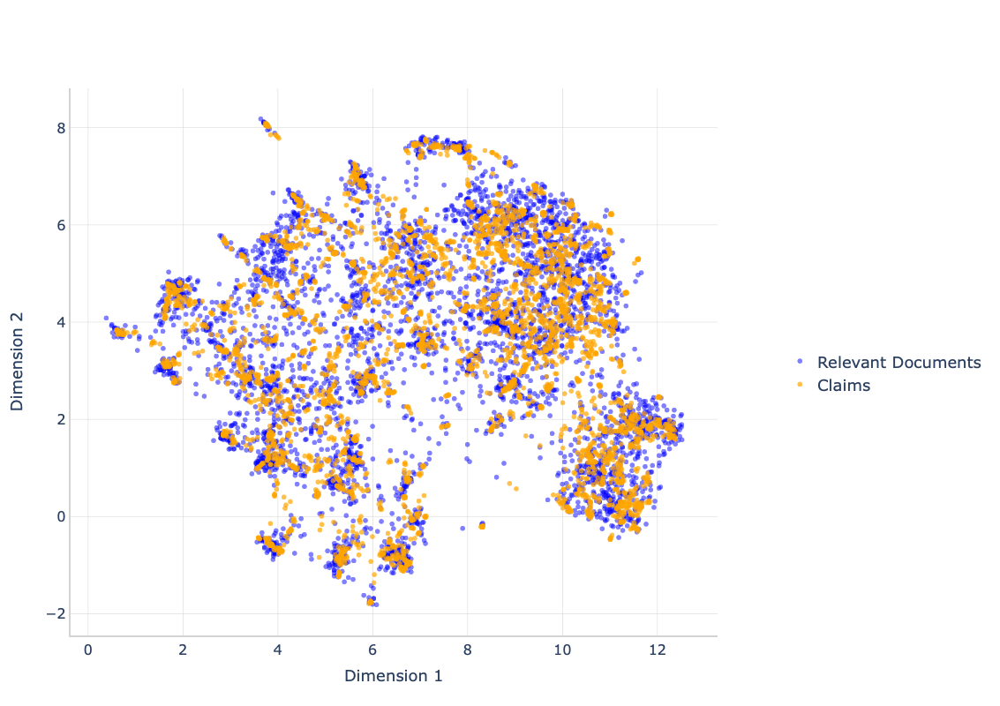

In [57]:
# prepare hover text
df.loc[df['topic'] == -1, 'topic_name'] = 'no_topic'
df_hover['topic_name']=df['topic_name'].copy()

hover_text = create_hover_text(df_hover, df_tfidf)

df_hover['hover_text'] = hover_text
  
marker_size = 6
fig = go.Figure()

# add facts 
fig.add_trace(
    go.Scatter(
        x=reduced_fact_embeddings[:,0][mask],
        y=reduced_fact_embeddings[:,1][mask],
        hoverinfo='text', 
        mode='markers',
        marker=dict(
            size=marker_size,
            color='blue',  # Set color to the recall
            #colorscale='RdYlGn',  # Use the desired colorscale
            #showscale=True
            opacity=0.5
        ),
        text=df_hover_expanded['supporting_fact_id'][mask],  # This will be displayed when hovering over points
        name='Relevant Documents'
    )
)

# add all claims in orange
fig.add_trace(
    go.Scatter(
        x=reduced_claim_embeddings[:,0],
        y=reduced_claim_embeddings[:,1],
        hoverinfo='text', 
        mode='markers',
        marker=dict(
            size=marker_size,
            color='orange',
            opacity=0.7
        ),
        text=hover_text,  # This will be displayed when hovering over points
        name='Claims'
    )
)

# Set the title and labels
fig = figure_layout(fig, width=1500, height=800)


fig.show()

/scratch/slurm_tmpdir/job_22450018/ipykernel_547932/18036752.py:8: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



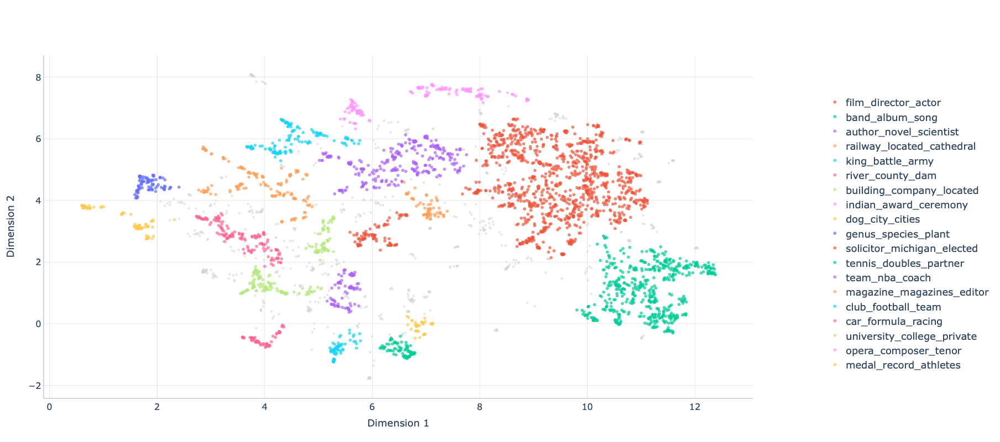

In [58]:
# Get a list of unique topics
topics_sorted = df['topic'].unique()

# Sort topics by recall for legend
topics_sorted = list(df.groupby('topic').mean().sort_values('bert_recall', ascending=False).index)

# Create a colormap with the same number of colors as there are unique topics
colormap = matplotlib.cm.get_cmap('viridis', len(topics_sorted))

# Create a color dictionary mapping each topic to a color
color_dict = {topic: colormap(i) for i, topic in enumerate(topics_sorted)}


# prepare hover text
df.loc[df['topic'] == -1, 'topic_name'] = 'no_topic'
df_hover['topic_name']=df['topic_name'].copy()
hover_text = df_hover.apply(lambda row: f"Topic: {row['topic_name']}<br>Recall: {row['recall']}<br>Claim: {row['claim']}", axis=1)



topic_dict = dict(zip(df['topic'], df['topic_name']))

recall_dict = dict(df.groupby('topic').agg(['mean']).sort_values([('bert_recall', 'mean')])[('bert_recall', 'mean')])
min_recall = min(recall_dict.values())
max_recall = max(recall_dict.values())


# Set up the figure size
fig = go.Figure()

# First, plot the light gray dots
gray_mask = df['topic'] == -1
fig.add_trace(go.Scatter(
                        x=reduced_claim_embeddings[:,0][gray_mask],
                        y=reduced_claim_embeddings[:,1][gray_mask],
                        mode='markers', 
                        marker=dict(color='lightgray', size=5, opacity=0.5),
                        text=hover_text[gray_mask], # This will be displayed when hovering over points
                        hoverinfo='text', 
                        showlegend=False
))

color_dict = {topic: recall for topic, recall in recall_dict.items()}
# Map 'bert_recall' values to colors
df['color'] = df['topic'].apply(lambda x: color_dict[x])

# sort by count
topics = list(df.groupby('topic').count().sort_values('bert_recall', ascending=False).index)


for topic in topics:
    if topic != -1:
        # Then, plot the colored dots
        colored_mask = df['topic'] == topic

        fig.add_trace(go.Scatter(
                                 x=reduced_claim_embeddings[:,0][colored_mask],
                                 y=reduced_claim_embeddings[:,1][colored_mask],
                                 mode='markers',
                                 text=hover_text[colored_mask],
                                 name=topic_dict[topic],
                                 hoverinfo='text',
                                 marker=dict(
                                     color=color_dict[topic],  # Assign color from color_dict
                                     size=6,
                                     opacity=0.7),
                                 showlegend=True
                                ))

# Set the title and labels
fig = figure_layout(fig, width=1500, height=800)


# Show the plot
fig.show()


In [ ]:
import plotly.graph_objects as go
import numpy as np
import pandas as pd
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.pyplot as plt

# prepare hover text
df.loc[df['topic'] == -1, 'topic_name'] = 'no_topic'
df_hover['topic_name']=df['topic_name'].copy()
hover_text = df_hover.apply(lambda row: f"Topic: {row['topic_name']}<br>Recall: {row['recall']}<br>Claim: {row['claim']}", axis=1)

recall_dict = dict(df.groupby('topic').agg(['mean']).sort_values([('bert_recall', 'mean')])[('bert_recall', 'mean')])
min_recall = min(recall_dict.values())
max_recall = max(recall_dict.values())

# create topic dict
topic_dict = dict(zip(df['topic'], df['topic_name']))
for key in topic_dict:
    topic_dict[key] = f'{topic_dict[key]} ({np.round(recall_dict[key],2)})'    
    
# Set up the figure size
fig = go.Figure()

# First, plot the light gray dots
gray_mask = df['topic'] == -1
fig.add_trace(go.Scatter(
                        x=df_embeddings[0][gray_mask], 
                        y=df_embeddings[1][gray_mask], 
                        mode='markers', 
                        marker=dict(color='lightgray', size=5, opacity=0.5),
                        text=hover_text[gray_mask],  # This will be displayed when hovering over points
                        hoverinfo='text',
                        showlegend=False
))
   



color_dict = {topic: recall for topic, recall in recall_dict.items()}
# Map 'bert_recall' values to colors
df['color'] = df['topic'].apply(lambda x: color_dict[x])

# get legend ordered according to recall
topics = list(df.groupby('topic').mean().sort_values('bert_recall', ascending=False).index)

for topic in topics:
    if topic != -1:
        # Then, plot the colored dots
        colored_mask = df['topic'] == topic

        fig.add_trace(go.Scatter(x=df_embeddings[0][colored_mask], 
                                 y=df_embeddings[1][colored_mask], 
                                 mode='markers',
                                 text=hover_text[colored_mask],
                                 hoverinfo='text',
                                 name=topic_dict[topic],
                                 marker=dict(
                                     color=df['color'][colored_mask],
                                     size=6,
                                     colorscale=[(0, 'red'), (0.5,'orange'), (1, 'lime')],
                                     cmin=min_recall,
                                     cmax=max_recall,
                                     colorbar=dict(title="Recall", thickness=20, len=0.64, titleside='top'),
                                     showscale=True,
                                     opacity=0.7),
                                 showlegend=True
                                ))

# Set the title and labels
fig.update_layout(
    title={
        'text': 'Clustered Claims - Recall',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font': dict(
            size=30,  # Adjust as necessary
           # family="bold"  # The 'bold' part makes the title bold
        )
    },
    legend=dict(
        x=1.1,
        y=0.48,
    ),
    xaxis=dict(
        title='Dimension 1',
        gridcolor='lightgrey',  # Set the color of the grid lines to light gray
        gridwidth=0.5,  # Set the width of the grid lines
        showline=True,  # Show the line for the x-axis
        linecolor='lightgrey',  # Set the color of the x-axis line to black
        linewidth=2,  # Set the width of the x-axis line
        zeroline=False
    ),
    yaxis=dict(
        title='Dimension 2',
        gridcolor='lightgrey',  # Set the color of the grid lines to light gray
        gridwidth=0.5,  # Set the width of the grid lines
        showline=True,  # Show the line for the y-axis
        linecolor='lightgrey',  # Set the color of the y-axis line to black
        linewidth=2,# Set the width of the y-axis line
        zeroline=False
    ),
    autosize=False,
    plot_bgcolor='white',  # Set the background color to white
    width=1500,  # Width in pixels
    height=800,  # Height in pixels
)

# Show the plot
fig.show()


In [344]:
import kaleido

In [ ]:
import plotly.io as pio
fig.write_image("plots/clustered_recall.png")

In [ ]:
import plotly.graph_objects as go
import numpy as np
import pandas as pd
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.pyplot as plt

# prepare hover text
df.loc[df['topic'] == -1, 'topic_name'] = 'no_topic'
df_hover['topic_name']=df['topic_name'].copy()
hover_text = df_hover.apply(lambda row: f"Topic: {row['topic_name']}<br>Hits: {row['hits']}<br>Claim: {row['claim']}", axis=1)


recall_dict = dict(df.groupby('topic').agg(['mean']).sort_values([('bert_hits', 'mean')])[('bert_hits', 'mean')])
min_recall = min(recall_dict.values())
max_recall = max(recall_dict.values())

# create topic dict
topic_dict = dict(zip(df['topic'], df['topic_name']))
for key in topic_dict:
    topic_dict[key] = f'{topic_dict[key]} ({np.round(recall_dict[key],2)})'
    
# Set up the figure size
fig = go.Figure()

# First, plot the light gray dots
gray_mask = df['topic'] == -1
fig.add_trace(go.Scatter(
                        x=df_embeddings[0][gray_mask], 
                        y=df_embeddings[1][gray_mask], 
                        mode='markers', 
                        marker=dict(color='lightgray', size=5, opacity=0.5),
                        text=hover_text[gray_mask],  # This will be displayed when hovering over points
                        hoverinfo='text',
                        showlegend=False
))

color_dict = {topic: recall for topic, recall in recall_dict.items()}
# Map 'bert_recall' values to colors
df['color'] = df['topic'].apply(lambda x: color_dict[x])

# get legend ordered according to recall
topics = list(df.groupby('topic').mean().sort_values('bert_hits', ascending=False).index)

for topic in topics:
    if topic != -1:
        # Then, plot the colored dots
        colored_mask = df['topic'] == topic

        fig.add_trace(go.Scatter(x=df_embeddings[0][colored_mask], 
                                 y=df_embeddings[1][colored_mask], 
                                 mode='markers',
                                 text=hover_text[colored_mask],
                                 hoverinfo='text',
                                 name=topic_dict[topic],
                                 marker=dict(
                                     color=df['color'][colored_mask],
                                     size=6,
                                     colorscale=[(0, 'red'), (0.5,'orange'), (1, 'lime')],
                                     cmin=min_recall,
                                     cmax=max_recall,
                                     colorbar=dict(title="Hits", thickness=20, len=0.64, titleside='top'),
                                     showscale=True,
                                     opacity=0.7),
                                 showlegend=True
                                ))

# Set the title and labels
fig.update_layout(
    title={
        'text': 'Clustered Claims - Hits',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font': dict(
            size=30,  # Adjust as necessary
           # family="bold"  # The 'bold' part makes the title bold
        )
    },
    legend=dict(
        x=1.1,
        y=0.48,
    ),
    xaxis=dict(
        title='Dimension 1',
        gridcolor='lightgrey',  # Set the color of the grid lines to light gray
        gridwidth=0.5,  # Set the width of the grid lines
        showline=True,  # Show the line for the x-axis
        linecolor='lightgrey',  # Set the color of the x-axis line to black
        linewidth=2,  # Set the width of the x-axis line
        zeroline=False
    ),
    yaxis=dict(
        title='Dimension 2',
        gridcolor='lightgrey',  # Set the color of the grid lines to light gray
        gridwidth=0.5,  # Set the width of the grid lines
        showline=True,  # Show the line for the y-axis
        linecolor='lightgrey',  # Set the color of the y-axis line to black
        linewidth=2,# Set the width of the y-axis line
        zeroline=False
    ),
    autosize=False,
    plot_bgcolor='white',  # Set the background color to white
    width=1500,  # Width in pixels
    height=800,  # Height in pixels
)

# Show the plot
fig.show()